<a href="https://colab.research.google.com/github/dineshreddy221/Natural-Language-Processing/blob/main/Amazon_sprint2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

$$ Sprint\ 2 $$

$$ SPRINT - 2 $$
<h2>Work on the below mentioned Visualizations for exploratory data analysis:</h2>
<li>Distribution of Ratings</li>
<li>Popular words in Positive Reviews (4-5 Rating)</li>
<li>Popular words in Negative Reviews (1-2 Rating)</li>
<li>Distribution of Helpfulness</li>
<li>How does rating affect Helpfulness?</li>
<li>How does word count vary by rating?</li>
<li>Etc…</li>
<B>Note - Use this blog written by Rob Castellano to understand the data analysis and how he generated insights (conclusion) from the visualizations.</B>
 


In [1]:
import warnings
warnings.filterwarnings("ignore")

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re

In [88]:
# Loading the dataset 
df = pd.read_csv("/content/drive/MyDrive/text_review_data.csv")
df.head()

,Unnamed: 0,Unnamed: 0.1,Unnamed: 0.1.1,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,ReviewSummary,ReviewText,Helpfulness
0,0,0,0,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned ...,1.0
1,1,1,1,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanu...,NaN
2,2,2,2,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a f...,1.0
3,3,3,3,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient ...,1.0
4,4,4,4,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wi...,NaN


In [89]:
df.drop(['Unnamed: 0','Unnamed: 0.1','Unnamed: 0.1.1'],inplace=True,axis = 1)

In [5]:
df.describe()

,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Helpfulness
count,568454.000000,568454.00000,568454.000000,5.684540e+05,298402.000000
mean,1.743817,2.22881,4.183199,1.296257e+09,0.776975
std,7.636513,8.28974,1.310436,4.804331e+07,0.346321
min,0.000000,0.00000,1.000000,9.393408e+08,0.000000
25%,0.000000,0.00000,4.000000,1.271290e+09,0.600000
50%,0.000000,1.00000,5.000000,1.311120e+09,1.000000
75%,2.000000,2.00000,5.000000,1.332720e+09,1.000000
max,866.000000,923.00000,5.000000,1.351210e+09,3.000000


In [6]:
df.isnull().sum()

ProductId                      0
UserId                         0
ProfileName                    0
HelpfulnessNumerator           0
HelpfulnessDenominator         0
Score                          0
Time                           0
ReviewSummary                  0
ReviewText                     0
Helpfulness               270052
dtype: int64

In [90]:
# filling the null values in Helpfulness column with mean
df['Helpfulness'] = df['Helpfulness'].fillna(df['Helpfulness'].median())        

In [8]:
df.columns

Index(['ProductId', 'UserId', 'ProfileName', 'HelpfulnessNumerator',
       'HelpfulnessDenominator', 'Score', 'Time', 'ReviewSummary',
       'ReviewText', 'Helpfulness'],
      dtype='object')

### Distribution of Ratings

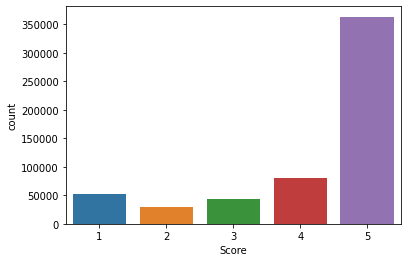

In [9]:
sns.countplot(data=df, x='Score')

<li> The countplot shows that the rating of score, the 5 rating is having the heighest count of above 350000 and the second heighest rating is having for 4 rating with the count of 100000 and the least score of rating is for 2 with the count below 50000.</li>

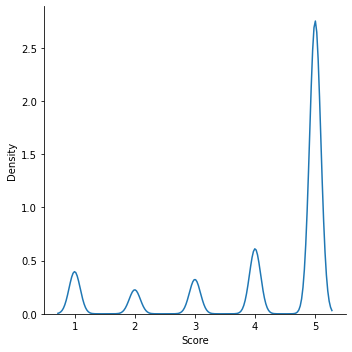

In [10]:
sns.displot(data=df, x='Score', kind='kde')

### Popular words in Positive Reviews (4-5 Rating)

In [115]:
positive_words = df['ReviewSummary'][df['Score']>=4]
positive_words = "".join(positive_words)
low_pos_words = positive_words.lower()
pos_words = low_pos_words.split()
print(len(pos_words))
pos_words

1777842


['good',
 'quality',
 'dog',
 'food',
 '"delight"',
 'says',
 'it',
 'all',
 'great',
 'taffy',
 'nice',
 'taffy',
 'great!',
 'just',
 'as',
 'good',
 'as',
 'the',
 'expensive',
 'brands!',
 'wonderful,',
 'tasty',
 'taffy',
 'yay',
 'barley',
 'healthy',
 'dog',
 'food',
 'the',
 'best',
 'hot',
 'sauce',
 'in',
 'the',
 'world',
 'my',
 'cats',
 'love',
 'this',
 '"diet"',
 'food',
 'better',
 'than',
 'their',
 'regular',
 'food',
 'fresh',
 'and',
 'greasy!',
 'strawberry',
 'twizzlers',
 '-',
 'yummy',
 'lots',
 'of',
 'twizzlers,',
 'just',
 'what',
 'you',
 'expect.',
 'love',
 'it!',
 'great',
 'sweet',
 'candy!',
 'home',
 'delivered',
 'twizlers',
 'always',
 'fresh',
 'twizzlers',
 'delicious',
 'product!',
 'twizzlers',
 'please',
 'sell',
 'these',
 'in',
 'mexico!!',
 'twizzlers',
 '-',
 'strawberry',
 'great',
 'bargain',
 'for',
 'the',
 'price',
 'yummy!',
 'the',
 'best',
 'hot',
 'sauce',
 'in',
 'the',
 'world',
 'great',
 'machine!',
 'this',
 'is',
 'my',
 'tast

### Popular words in Negative Reviews (1-2 Rating)

In [116]:
negative_words = df['ReviewSummary'][df['Score']<=2]
negative_words = "".join(negative_words)
low_neg_words = negative_words.lower()
neg_words = low_neg_words.split()
print(len(neg_words))
neg_words

357369


['not',
 'as',
 'advertised',
 'cough',
 'medicine',
 'my',
 'cats',
 'are',
 'not',
 'fans',
 'of',
 'the',
 'new',
 'food',
 'poor',
 'taste',
 'nasty',
 'no',
 'flavor',
 "don't",
 'like',
 'it',
 'stale',
 'product.',
 'taste',
 'is',
 'not',
 'so',
 'good.',
 'warning!',
 'warning!',
 '-alcohol',
 'sugars!',
 'nothing',
 'special',
 'no',
 'tea',
 'flavor',
 'bad',
 'low',
 'carb',
 'angel',
 'food',
 'puffs',
 'not',
 'for',
 'me',
 'broken',
 'bottle',
 'bottoms!',
 'rip',
 'off',
 'price',
 'tasteless',
 'but',
 'low',
 'calorie',
 'very',
 'low',
 'quality',
 'not',
 'banana',
 'runts',
 'altoids',
 'smalls',
 'these',
 'just',
 "don't",
 'do',
 'it',
 'for',
 'me',
 'as',
 'breath',
 'mints',
 'nearly',
 'killed',
 'the',
 'cats',
 'changed',
 'formula',
 'makes',
 'cats',
 'sick!!!!',
 'price',
 'cannot',
 'be',
 'correct',
 'not',
 'a',
 'real',
 'tea',
 'not',
 'good',
 'furniture',
 'polish',
 'taste',
 'taste',
 'is',
 'neutral,',
 'quantity',
 'is',
 'deceitful!',
 'dis

### Distribution of Helpfulness

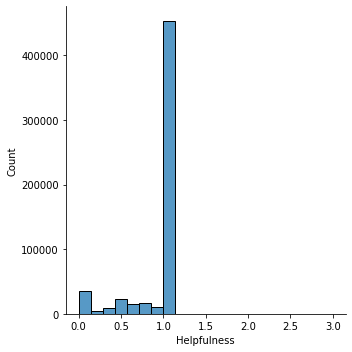

In [22]:
sns.displot(data=df, x='Helpfulness')

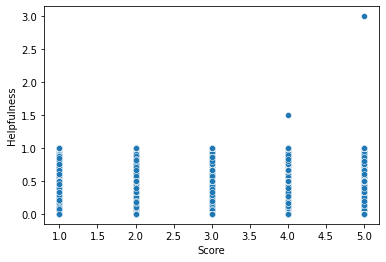

In [23]:
sns.scatterplot(data =df, x= df['Score'], y=df['Helpfulness'] )
plt.show()

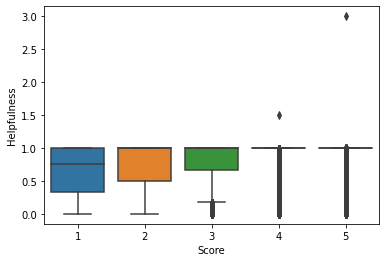

In [24]:
sns.boxplot(data=df, x='Score', y='Helpfulness')

### Sentimental Analysis

In [21]:
from wordcloud import WordCloud, STOPWORDS

### Negative Sentimental Analysis

In [101]:
Negative_words = ' '.join(neg_words)
print(Negative_words)

not as advertised cough medicine my cats are not fans of the new food poor taste nasty no flavor don't like it stale product. taste is not so good. warning! warning! -alcohol sugars! nothing special no tea flavor bad low carb angel food puffs not for me broken bottle bottoms! rip off price tasteless but low calorie very low quality not banana runts altoids smalls these just don't do it for me as breath mints nearly killed the cats changed formula makes cats sick!!!! price cannot be correct not a real tea not good furniture polish taste taste is neutral, quantity is deceitful! disappointed sad outcome don't waste your money if you can't handle caffeine, this is not for you. reeks like chemicals disappointed! lie!!!! over priced chips and lack rice taste so awful i can barely describe very dissapointed what quantity is it! never arrived awful does not taste very good no no bitter waste of money cat won't go near it! msg ham base poor item packaging awful disappointing look elsewhere for 

In [102]:
#words = ' '.join(temp_df['ReviewSummary'])

Negative_cleaned_word = "".join([word for word in Negative_words
                            if 'http' not in word
                                and not word.startswith('$')
                                and not word.startswith('0123456789')
                                and not word.endswith('!')
                                and not word.endswith('?')
                                and not word.endswith("'")
                                and not word.endswith('.')
                                and not word.endswith('"')
                                and not word.endswith('*')
                                and not word.startswith('-')
                                and not word.endswith(',')
                                and not word.endswith(')')
                                and not word.startswith('(')
                                and word != 'mm'
                            ])

In [103]:
Negative_cleaned_word

'not as advertised cough medicine my cats are not fans of the new food poor taste nasty no flavor dont like it stale product taste is not so good warning warning alcohol sugars nothing special no tea flavor bad low carb angel food puffs not for me broken bottle bottoms rip off price tasteless but low calorie very low quality not banana runts altoids smalls these just dont do it for me as breath mints nearly killed the cats changed formula makes cats sick price cannot be correct not a real tea not good furniture polish taste taste is neutral quantity is deceitful disappointed sad outcome dont waste your money if you cant handle caffeine this is not for you reeks like chemicals disappointed lie over priced chips and lack rice taste so awful i can barely describe very dissapointed what quantity is it never arrived awful does not taste very good no no bitter waste of money cat wont go near it msg ham base poor item packaging awful disappointing look elsewhere for your whole grains 70% of t

In [104]:
wordcloud = WordCloud(stopwords=STOPWORDS,
                      background_color='black',
                      width=1600,
                      height=800
                     ).generate(Negative_cleaned_word)

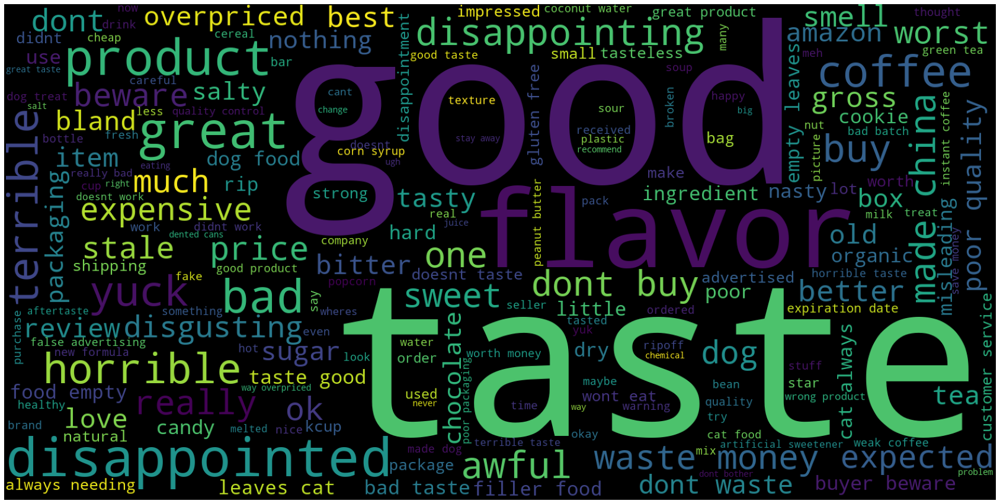

In [105]:
plt.figure(1,figsize=(30,20))
plt.imshow(wordcloud)
plt.axis('off')
plt.show()

### Positive Sentimental Analysis

In [117]:
Positive_words = ' '.join(pos_words)
Positive_words

'good quality dog food "delight" says it all great taffy nice taffy great! just as good as the expensive brands! wonderful, tasty taffy yay barley healthy dog food the best hot sauce in the world my cats love this "diet" food better than their regular food fresh and greasy! strawberry twizzlers - yummy lots of twizzlers, just what you expect. love it! great sweet candy! home delivered twizlers always fresh twizzlers delicious product! twizzlers please sell these in mexico!! twizzlers - strawberry great bargain for the price yummy! the best hot sauce in the world great machine! this is my taste... best of the instant oatmeals good instant great irish oatmeal for those in a hurry! satisfying love gluten free oatmeal!!! it\'s oatmeal good way to start the day.... wife\'s favorite breakfast why wouldn\'t you buy oatmeal from mcanns? tastes great! oatmeal for oatmeal lovers food-great good hot breakfast great taste and convenience good very good but next time i won\'t order the variety pack

In [118]:
#words = ' '.join(temp_df['ReviewSummary'])

Positive_cleaned_word = "".join([word for word in Positive_words
                            if 'http' not in word
                                and not word.endswith('!')
                                and not word.endswith('.')
                                and not word.endswith('?')
                                and not word.endswith('~')
                                and not word.endswith("'")
                                and not word.endswith('"')
                                and word != 'RT'
                            ])

In [119]:
Positive_cleaned_word

'good quality dog food delight says it all great taffy nice taffy great just as good as the expensive brands wonderful, tasty taffy yay barley healthy dog food the best hot sauce in the world my cats love this diet food better than their regular food fresh and greasy strawberry twizzlers - yummy lots of twizzlers, just what you expect love it great sweet candy home delivered twizlers always fresh twizzlers delicious product twizzlers please sell these in mexico twizzlers - strawberry great bargain for the price yummy the best hot sauce in the world great machine this is my taste best of the instant oatmeals good instant great irish oatmeal for those in a hurry satisfying love gluten free oatmeal its oatmeal good way to start the day wifes favorite breakfast why wouldnt you buy oatmeal from mcanns tastes great oatmeal for oatmeal lovers food-great good hot breakfast great taste and convenience good very good but next time i wont order the variety pack hot and good came back for more ) y

In [120]:
wordcloud = WordCloud(stopwords=STOPWORDS,
                      background_color='black',
                      width=1600,
                      height=800
                     ).generate(Positive_cleaned_word)

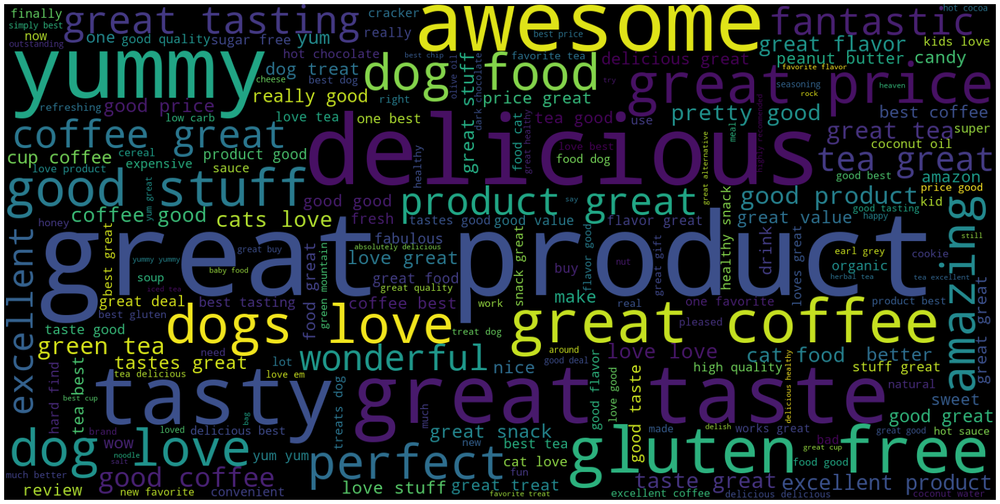

In [121]:
plt.figure(figsize=(30,20))
plt.imshow(wordcloud)
plt.axis('off')
plt.show()